# Gemini Flash Introduction

<table align="left">
  <td>
    <a target="_blank" href="https://colab.research.google.com/github/google-gemini/cookbook/blob/main/quickstarts/Gemini_Flash_Introduction.ipynb"><img src="https://www.tensorflow.org/images/colab_logo_32px.png" />Run in Google Colab</a>
  </td>
</table>

## Installing the latest version of the Gemini SDK

In [1]:
!pip install -q -U google-generativeai # Install the Python SDK

## Import the Gemini python SDK

In [2]:
import google.generativeai as genai

## Set up your API key

To run the following cell, your API key must be stored it in a Colab Secret named `GOOGLE_API_KEY`. If you don't already have an API key, or you're not sure how to create a Colab Secret, see the [Authentication](https://github.com/google-gemini/cookbook/blob/main/quickstarts/Authentication.ipynb) quickstart for an example.

In [3]:
from google.colab import userdata

GOOGLE_API_KEY=userdata.get('GOOGLE_API_KEY')
genai.configure(api_key=GOOGLE_API_KEY)

## Completing the Setup

Next, we will set up a model version and get ready to make some prompts.

In [4]:
version = 'models/gemini-1.5-flash'
model = genai.GenerativeModel(version)

Let's consider the following scenario. You have just been hired as a student tutor at UC Berkeley! You're assigned various tasks across campus, helping a variety of students through their homework. Lets use some of the prompts below to help out the students

First, you are tasked to help Derek create a poem from scratch. This poem should be a free verse about the pasta Linguine.

In [5]:
prompt = """Create a free verse about the pasta Linguine. Make it descriptive
about the shape, taste, and texture of pasta. Make the poem at least five lines
long."""

In [6]:
response = model.generate_content(prompt)
print(response.text)

Long, slender ribbons,
a pale ivory gleam,
caught in the sun's slant,
a gentle curve, a subtle sway.

The tongue finds yielding resistance,
a soft bite, then surrender
to a creamy, comforting warmth.
Flavors cling, a delicate embrace,
garlic's whisper, tomato's bold kiss,
basil's bright exhale.

Each strand, a tiny vessel,
absorbing sauce, a subtle alchemy.
Smooth, yet not slick,
a perfect dance on the palate,
a lingering satisfaction.
The memory, long after the last bite.



As an aside, we will be using the `genai.upload_file()` method using the File API from Gemini API. This allows users to upload media files, such as images, audio, and video to be used as input for prompting and generating AI responses. This feature integrates media with text-based prompts to enhance the context and relevance of the generated outputs.

Now, you need to help architecture student Diana place pots and pans in the following kitchen without messing up the style of the existing design.

Thus, we need to determine the key items in this kitchen and the color of these items.

Create a prompt that will take in an image of a room in a house and will redecorate that room given the specifications above.

In [7]:
!wget -O kitchen.jpeg "https://video.udacity-data.com/topher/2024/June/667b0908_kitchen/kitchen.jpeg"

image_upload = genai.upload_file(path='kitchen.jpeg')

--2024-12-11 13:01:38--  https://video.udacity-data.com/topher/2024/June/667b0908_kitchen/kitchen.jpeg
Resolving video.udacity-data.com (video.udacity-data.com)... 104.19.142.72, 104.19.140.72, 104.19.141.72, ...
Connecting to video.udacity-data.com (video.udacity-data.com)|104.19.142.72|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1093598 (1.0M) [image/jpeg]
Saving to: ‘kitchen.jpeg’

kitchen.jpeg        100%[===================>]   1.04M  --.-KB/s    in 0.04s   

2024-12-11 13:01:39 (27.1 MB/s) - ‘kitchen.jpeg’ saved [1093598/1093598]



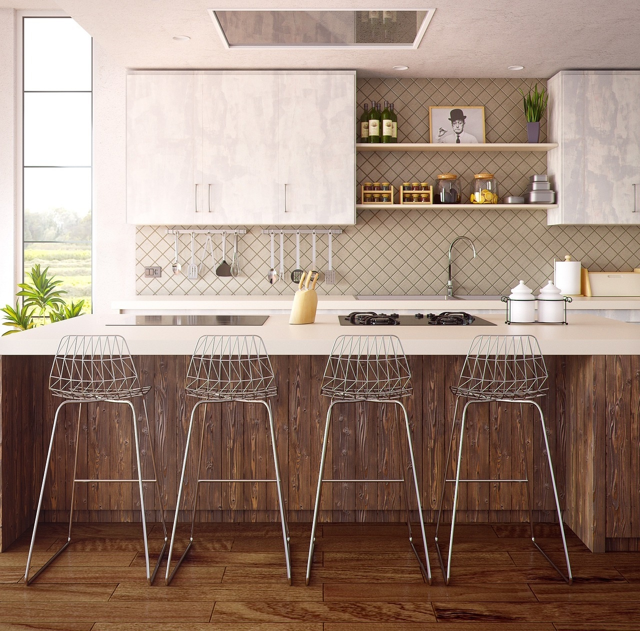

In [ ]:
from PIL import Image
image = Image.open('kitchen.jpeg')
resized_image = image.resize((int(image.size[0] / 2), int(image.size[1] / 2)))

resized_image

In [8]:
prompt = """This image contains a a kitchen with a seating area (four chairs),
cabinets, stove, a large window, and a knife holder. Give a description of the
following room, including the key components and each of the colors (be specific
about what exact shade) of the items. Explain in what location we could place 5
pots and pans so that the kitchen retains its minimalistic appeal and clutter
doesn't increase substantially."""

In [ ]:
model = genai.GenerativeModel('gemini-1.5-flash')
response = model.generate_content([prompt, image_upload])
print(response.text)

The kitchen features a minimalist design with a focus on clean lines and a neutral color palette. The focal point of the room is the large window that offers a view of the outside world. 

The cabinets are a soft white, with a slightly textured surface that adds a touch of depth.  The countertop is a cool white, and the backsplash is made of beige ceramic tiles arranged in a diamond pattern. The stovetop is black, and the sink is stainless steel.

The seating area consists of four wire-framed bar stools, in a silvery gray color, with a wooden base stained in a rich dark brown. The wooden base is made of planks,  resembling rustic reclaimed wood.

The floor is made of wood, stained in a rich brown hue with a warm undertone. There is a knife holder made of light wood, positioned on the countertop between the stovetop and the sink.

To retain the minimalistic appeal, the pots and pans can be stored in the following locations:

1. **Inside the cabinets:** This is the most practical and spa

Now, Harbani, a student in a film class needs your help with understanding a piece of audio given to her.

Help decide what the audio file is comprised of and what kind of mood it sets.

In [9]:
!wget -O summer-rainampthunder-162009.mp3 "https://video.udacity-data.com/topher/2024/June/667b09e0_summer-rain-thunder/summer-rain-thunder.mp3"

audio_upload = genai.upload_file(path='summer-rainampthunder-162009.mp3')

--2024-12-11 13:05:16--  https://video.udacity-data.com/topher/2024/June/667b09e0_summer-rain-thunder/summer-rain-thunder.mp3
Resolving video.udacity-data.com (video.udacity-data.com)... 104.19.142.72, 104.19.140.72, 104.19.141.72, ...
Connecting to video.udacity-data.com (video.udacity-data.com)|104.19.142.72|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 3889152 (3.7M) [audio/mpeg]
Saving to: ‘summer-rainampthunder-162009.mp3’

summer-rainampthund 100%[===================>]   3.71M  23.6MB/s    in 0.2s    

2024-12-11 13:05:16 (23.6 MB/s) - ‘summer-rainampthunder-162009.mp3’ saved [3889152/3889152]



In [ ]:
from IPython.display import Audio

Audio("summer-rainampthunder-162009.mp3")

In [10]:
prompt = """Listen carefully to the following audio file, what's in it? What
mood does it set and what kind of film could it be used in?"""

response = model.generate_content([prompt, audio_upload])
print(response.text)

That audio clip contains a piece of dramatic, orchestral music.  It's predominantly low and ominous, building in intensity and featuring string instruments, brass, and possibly percussion.

The mood it sets is one of suspense, foreboding, and perhaps even impending doom or tragedy.  It feels dark, serious, and quite weighty.

This kind of music would be suitable for a film in several genres:

* **Thriller:** To accompany a tense scene, a chase sequence, or the revelation of a shocking secret.
* **Horror:**  To build anticipation before a jump scare or a moment of intense horror.
* **Drama:** To underscore a crucial moment of conflict, loss, or moral dilemma.
* **Sci-fi/Fantasy:**  To represent a looming threat, an approaching battle, or the feeling of being overwhelmed by powerful forces.

Essentially, any genre needing a score to evoke a sense of escalating tension or imminent danger would be a good fit for this music.



Finally, Vanessa on the Tennis team needs your help understanding why she has lost her last few matches. Her coach has told her that she is struggling to place the ball in the correct place.

Break down the following tennis film and summarize what each player does and where the ball lands. Explain how the winning player uses placement to win the point.

In [11]:
!wget -O tennis.mp4 "https://video.udacity-data.com/topher/2024/June/667b096b_tennis/tennis.mp4"

video_upload = genai.upload_file(path='tennis.mp4')

--2024-12-11 13:08:40--  https://video.udacity-data.com/topher/2024/June/667b096b_tennis/tennis.mp4
Resolving video.udacity-data.com (video.udacity-data.com)... 104.19.141.72, 104.19.140.72, 104.19.142.72, ...
Connecting to video.udacity-data.com (video.udacity-data.com)|104.19.141.72|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 15157892 (14M) [video/mp4]
Saving to: ‘tennis.mp4’

tennis.mp4          100%[===================>]  14.46M  32.8MB/s    in 0.4s    

2024-12-11 13:08:40 (32.8 MB/s) - ‘tennis.mp4’ saved [15157892/15157892]



In [ ]:
from IPython.display import Video

Video("tennis.mp4", embed=True, width=540)

In [12]:
prompt = """Describe the video. Describe how each tennis player hits the ball and
describe where the ball lands. Explain how the winning player positions the ball
to land in certain spots to win the point."""

response = model.generate_content([prompt, video_upload], request_options={"timeout": 600})
print(response.text)

Here is a description of the video:

The video is an aerial shot of a tennis match on a clay court. The camera is positioned directly overhead, providing a bird's-eye view of the entire court.  The court is a standard size with clear markings.

**The Tennis Match:**

The video shows a single point of a tennis match.  Two players are visible, one on each side of the net.  The quality of the video doesn’t allow for detailed analysis of their technique, but the general strokes can be observed.

* **Player 1 (serving):**  Initiates the point by serving the ball.  The video doesn’t provide the specific trajectory, but it appears to be a relatively standard serve, aimed at the service box.  It lands within the service box on the receiver’s side of the net.

* **Player 2 (receiver):** Returns the serve with a forehand groundstroke. The ball goes across the net. The video does not show the exact location it landed, however, judging by Player 1's follow-up shot, it appears to have landed in the